## Import Dependencies

In [2]:
%matplotlib inline
import random

import torch
import torch.nn as nn
import torch.nn.parallel
from torch import optim
import torch.utils.data

from torchvision import datasets
import torchvision.transforms as transforms
from torchvision import utils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

seed = 999
random.seed(seed)
torch.manual_seed(seed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


## Download the Celeb_a dataset

In [3]:
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp /content/drive/MyDrive/kaggle.json ~/.kaggle/
!kaggle datasets list -s 'Gender Classification 200K Images | CelebA'
!kaggle datasets download -d jessicali9530/celeba-dataset
!unzip -qq celeba-dataset.zip

Dataset URL: https://www.kaggle.com/datasets/jessicali9530/celeba-dataset
License(s): other
100% 1.33G/1.33G [00:08<00:00, 254MB/s]
100% 1.33G/1.33G [00:08<00:00, 171MB/s]


## Define Hyper Parameters


In [4]:
dataset_path = '/content/img_align_celeba'
workers = 2
batch_size = 128
image_size = 64
channels_number = 3
nz = 100
gen_filters = 64
dis_filters = 64
epochs = 5
lr = 2e-4
beta1 = .5
gpu_number = 1

## Create dataset

In [ ]:
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((.5, .5, .5), (.5, .5, .5)),
])
dataset = datasets.ImageFolder(root=dataset_path, transform=transform)

dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

### Plot some training data

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


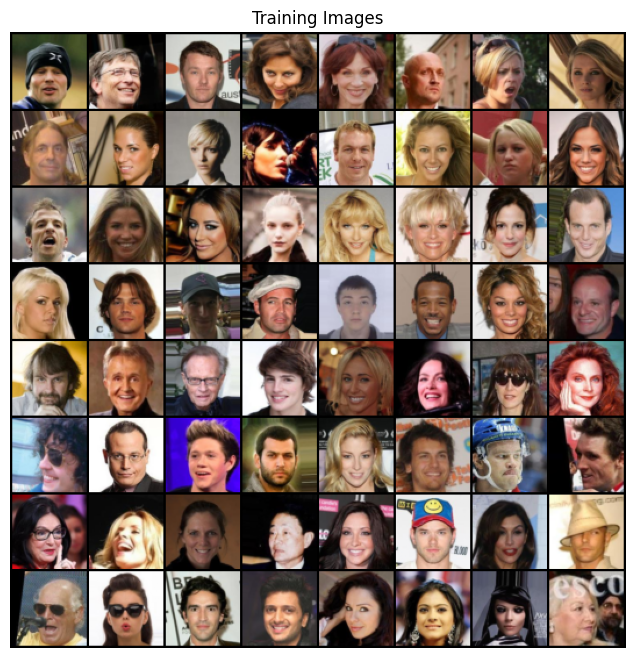

In [5]:
real_batch = next(iter(dataloader))
grid = utils.make_grid(real_batch[0].to(device))

plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(
    np.transpose(grid[:64], padding=2, normalize=True).cpu(), (1, 2, 0)
)
plt.show()

## Custom Weights Initialization

In [6]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, .0, .02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1., .02)
        nn.init.constant_(m.bias.data, 0)

## Build Generator Model

In [7]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu

        self.gen_net = nn.Sequential(
            nn.ConvTranspose2d(
                nz,
                gen_filters * 8,
                kernel_size=4,
                stride=1,
                padding=0,
                bias=False
            ),
            nn.BatchNorm2d(gen_filters * 8),
            nn.ReLU(True),

            nn.ConvTranspose2d(
                gen_filters * 8,
                gen_filters * 4,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False
            ),
            nn.BatchNorm2d(gen_filters * 4),
            nn.ReLU(True),

            nn.ConvTranspose2d(
                gen_filters * 4,
                gen_filters * 2,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False
            ),
            nn.BatchNorm2d(gen_filters * 2),
            nn.ReLU(True),

            nn.ConvTranspose2d(
                gen_filters * 2,
                gen_filters,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False
            ),
            nn.BatchNorm2d(gen_filters),
            nn.ReLU(True),

            nn.ConvTranspose2d(
                gen_filters,
                channels_number,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False
            ),
            nn.Tanh()
        )

    def forward(self, x):
        return self.gen_net(x)

### Apply The `weights_init` Function

In [8]:
gen_net = Generator(gpu_number).to(device)

if device.type == 'cuda' and gpu_number > 1:
    gen_net = nn.DataParallel(gen_net, list(range(gpu_number)))

gen_net.apply(weights_init)
print(gen_net)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Build Discriminator Model

In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu

        self.dis_net = nn.Sequential(
            nn.Conv2d(
                channels_number,
                dis_filters,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False
            ),
            nn.LeakyReLU(.2, inplace=True),

            nn.Conv2d(
                dis_filters,
                dis_filters * 2,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False
            ),
            nn.BatchNorm2d(dis_filters * 2),
            nn.LeakyReLU(.2, inplace=True),

            nn.Conv2d(
                dis_filters * 2,
                dis_filters * 4,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False
            ),
            nn.BatchNorm2d(dis_filters * 4),
            nn.LeakyReLU(.2, inplace=True),

            nn.Conv2d(
                dis_filters * 4,
                dis_filters * 8,
                kernel_size=4,
                stride=2,
                padding=1,
                bias=False
            ),
            nn.BatchNorm2d(dis_filters * 8),
            nn.LeakyReLU(.2, inplace=True),

            nn.Conv2d(
                dis_filters * 8,
                1,
                kernel_size=4,
                stride=1,
                padding=0,
                bias=False
            ),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.dis_net(x)

### Apply The `weights_init` Function

In [10]:
dis_net = Discriminator(gpu_number).to(device)

if device.type == 'cuda' and gpu_number > 1:
    dis_net = nn.DataParallel(dis_net, list(range(gpu_number)))

dis_net.apply(weights_init)
print(dis_net)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Config Loss Functions And Optimizers

In [11]:
loss_fn = nn.BCELoss()

fixed_noise = torch.randn(64, nz, 1, 1, device=device)

REAL = 1.
FAKE = 0.

gen_optim = optim.Adam(gen_net.parameters(), lr=lr, betas=(beta1, .999))
dis_optim = optim.Adam(dis_net.parameters(), lr=lr, betas=(beta1, .999))

## Train

In [ ]:
img_list = []
gen_losses = []
dis_losses = []
iters = 0

print(f'Starting Training Loop With {epochs} Epochs...')
# For each epoch
for epoch in range(epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        # Update discriminator network
        # Train with all real batches
        dis_net.zero_grad()

        real_x = data[0].to(device)
        b_size = real_x.size(0)
        label = torch.full((b_size,), REAL, dtype=torch.float, device=device)

        output = dis_net(real_x).view(-1)
        dis_real_error = loss_fn(output, label)
        dis_real_error.backward()
        D_x = output.mean().item()

        # Train with all fake batches
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = gen_net(noise)
        label.fill_(FAKE)

        output = dis_net(fake.detach()).view(-1)
        dis_fake_error = loss_fn(output, label)

        dis_fake_error.backward()
        D_G_z1 = output.mean().item()
        dis_error = dis_real_error + dis_fake_error

        dis_optim.step()

        # Update generator network
        gen_net.zero_grad()
        label.fill_(REAL)  # fake labels are real for generator cost

        output = dis_net(fake).view(-1)
        gen_error = loss_fn(output, label)
        gen_error.backward()
        D_G_z2 = output.mean().item()

        gen_optim.step()

        if i % 50 == 0:
            print(f"[{epoch}/{epochs}][{i}/{len(dataloader)}]\tDis_loss: {dis_error:.4f}\tGen_loss: {gen_error:.4f}\tD(x): {D_x:.4f}\tD(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}")

        gen_losses.append(gen_error.item())
        dis_losses.append(dis_error.item())

        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = gen_net(fixed_noise).detach().cpu()
            img_list.append(utils.make_grid(fake, padding=2, normalize=True))

        iters += 1

## Results

### How Discriminator And Generator's Losses Changed During Training

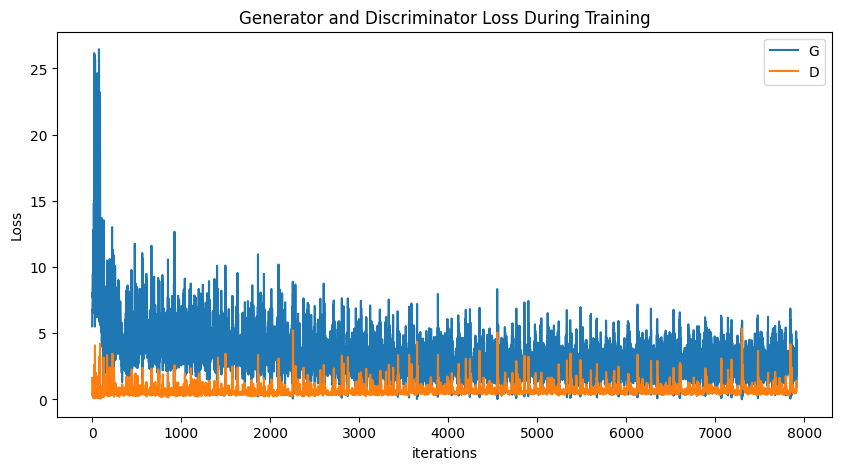

In [13]:
plt.figure(figsize=(10,5))
plt.title('Generator and Discriminator Loss During Training')
plt.plot(gen_losses,label='G')
plt.plot(dis_losses,label='D')
plt.xlabel('iterations')
plt.ylabel('Loss')
plt.legend()
plt.show()

### Visualization of Generator's progression

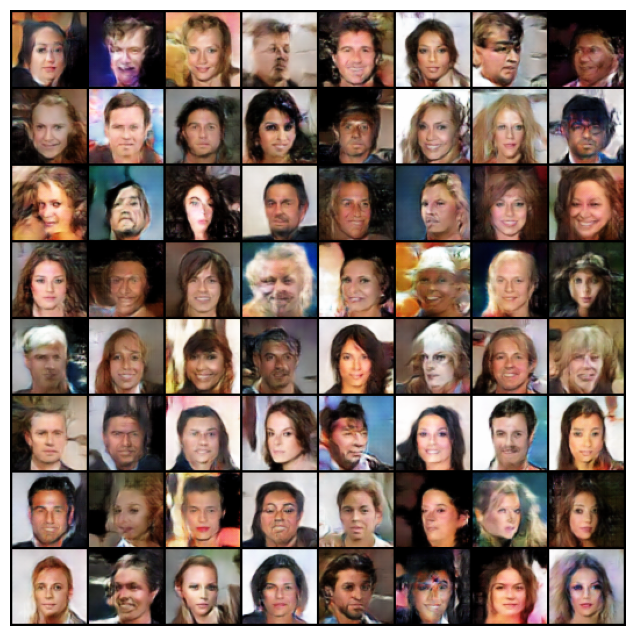

In [14]:
fig = plt.figure(figsize=(8,8))
plt.axis('off')
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Real Images vs. Fake Images

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


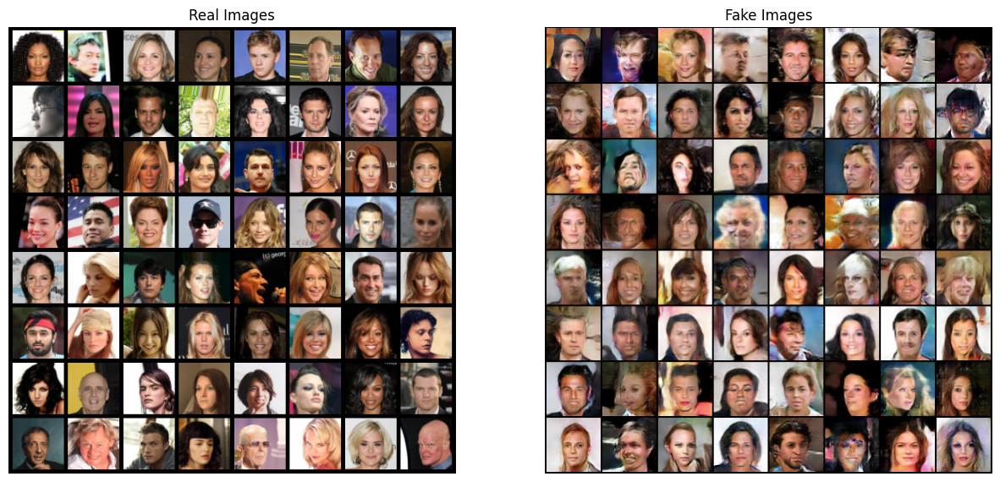

In [15]:
real_batch = next(iter(dataloader))
grid = utils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True)

plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.axis('off')
plt.title('Real Images')
plt.imshow(np.transpose(grid).cpu(), (1, 2, 0))

plt.subplot(1, 2, 2)
plt.axis('off')
plt.title('Fake Images')
plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
plt.show()

In [ ]:
torch.save(gen_net.state_dict(), 'celeb_a_generator.pth')